In [1]:
%pip install tf_keras_vis tflite-support-nightly

Note: you may need to restart the kernel to use updated packages.


ERROR: Could not find a version that satisfies the requirement tflite-support-nightly (from versions: none)
ERROR: No matching distribution found for tflite-support-nightly


# Create your dataset

1) Choose which classes you would like to add.

2) Create a dataset with your own photos

3) Separate your dataset into train and test subsets.

In [2]:
import os
import pandas as pd
from glob import glob

def create_dataframe_from_directories(path):
    data = []

    for label_dir in os.listdir(path):
        if os.path.isfile(label_dir):
            continue

        label_path_path = os.path.join(path, label_dir)
        for file in os.listdir(label_path_path):
            data.append([os.path.join(label_path_path, file), label_dir])
        
    return pd.DataFrame(data, columns = ["path", "label"])

In [3]:
train_df = create_dataframe_from_directories("dataset_train")
test_df = create_dataframe_from_directories("dataset_test")

In [4]:
LABEL_NAMES = pd.unique(train_df['label'])
LABEL_NAMES

array(['Haru', 'Miyuki', 'Pikou', 'Tommy'], dtype=object)

Display some images of your dataset

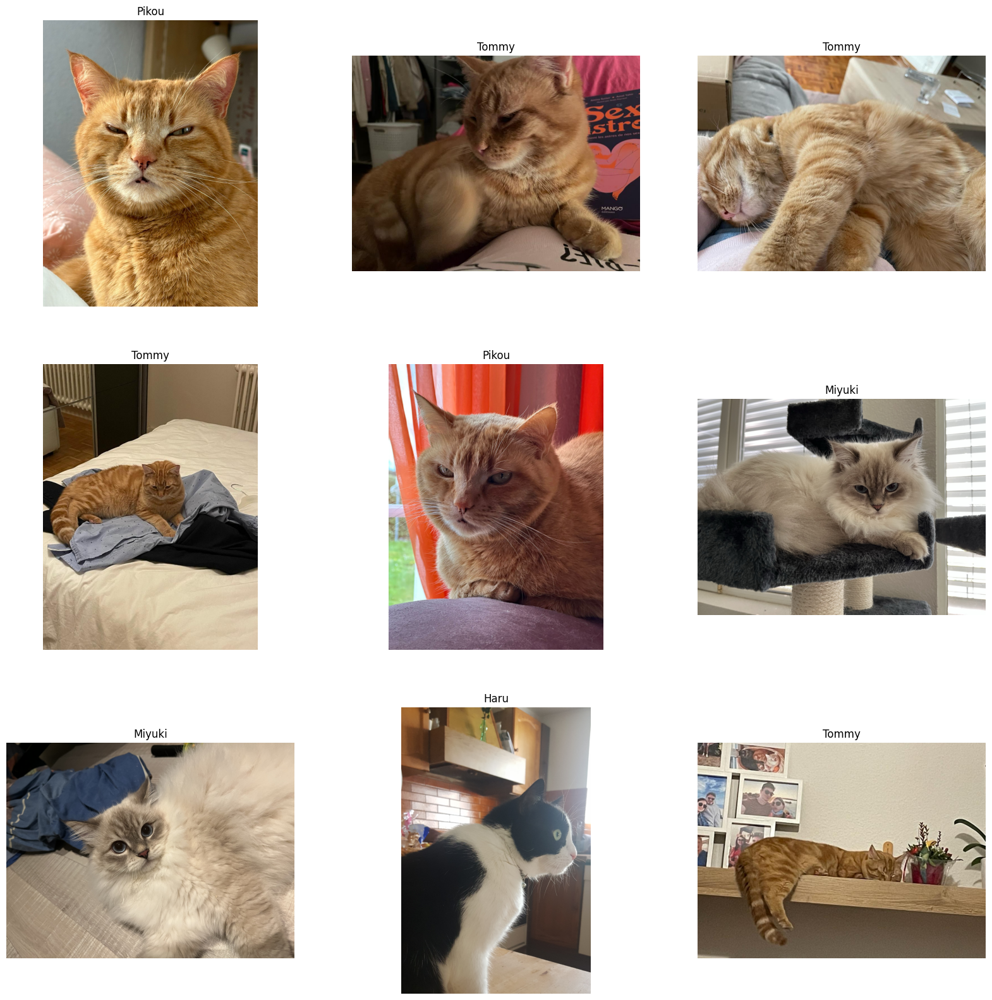

In [5]:
import matplotlib.pyplot as plt
import PIL
import PIL.Image
 
plt.figure(figsize=(20, 20))

i = 0
for _, rowdata in train_df.sample(frac=1).head(9).iterrows():
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(PIL.Image.open(rowdata.path))
    plt.title(rowdata.label)
    plt.axis("off")
    i += 1

# Explore your dataset


Count the number of examples per classes and plot an histogram of it

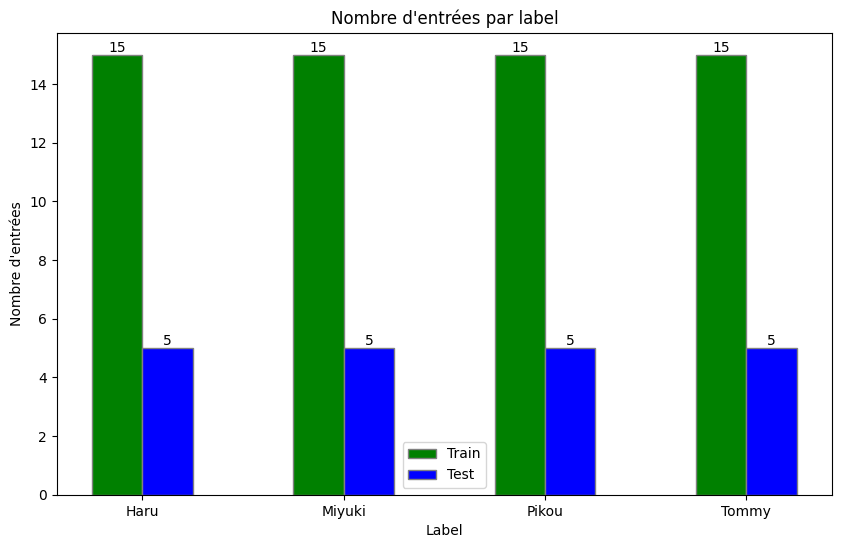

In [6]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

label_train_count = train_df['label'].value_counts()
label_test_count = test_df['label'].value_counts()

x_train = np.arange(len(label_train_count))
x_test = x_train + 0.25

plt.figure(figsize=(10, 6))

train_bars = plt.bar(x_train, label_train_count, color ='g', width=0.25, edgecolor='grey', label='Train')
test_bars = plt.bar(x_test, label_test_count, color ='blue', width=0.25, edgecolor='grey', label='Test')

plt.bar_label(train_bars)
plt.bar_label(test_bars)

plt.xlabel('Label')
plt.ylabel('Nombre d\'entrées')
plt.title('Nombre d\'entrées par label')
plt.xticks(x_train + 0.125, LABEL_NAMES)
plt.legend()
plt.show()

# Preprocessing steps

In [7]:
from tensorflow.keras.layers import (
    Resizing, Rescaling, RandomFlip, RandomRotation, RandomContrast, RandomZoom, RandomContrast, RandomBrightness
)

from tensorflow.keras import Sequential

IMG_HEIGHT = 224
IMG_WIDTH = 224

image_preprocesses = Sequential([
    Resizing(IMG_HEIGHT, IMG_WIDTH, crop_to_aspect_ratio=True),
    Rescaling(1. / 255)
])

image_augmentations = Sequential([
    # Choose some image augmentations layers
    # see which keras layers you can use
    # The kind of layers you will want to use starts with "Random".
    # See the following page for more information on data augmentation :
    # https://www.tensorflow.org/tutorials/images/data_augmentation
    RandomFlip(),
    RandomRotation(0.4),
    RandomContrast(0.2)
])

def open_images(paths):
    return np.stack([
        open_image(path) for path in paths
    ])

def open_image(path):
    with PIL.Image.open(path) as image:
        opened_img = image_preprocesses(np.asarray(image))
    
    return opened_img

def augment_images(images):
    return np.stack([
        image_augmentations(img) for img in images
    ])

Plot examples of preprocessed and augmented images

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


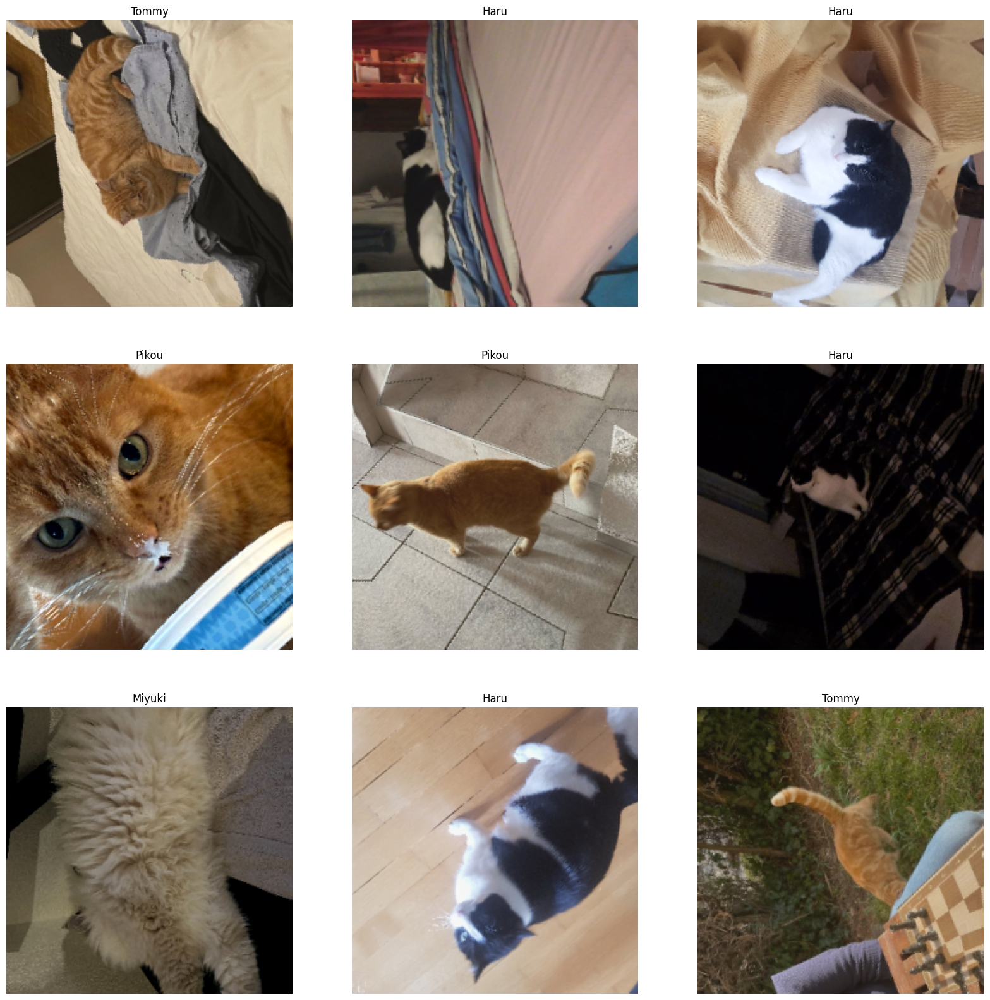

In [8]:
import matplotlib.pyplot as plt
import PIL
import PIL.Image

plt.figure(figsize=(20, 20))

i = 0
for _, rowdata in train_df.sample(frac=1).head(9).iterrows():
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(image_augmentations(open_image(rowdata.path)))
    plt.title(rowdata.label)
    plt.axis("off")
    i += 1


## Define model

In [25]:
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.losses import SparseCategoricalCrossentropy
from tensorflow.keras import Model
from tensorflow.keras.layers import (
    GlobalAveragePooling2D,
    Dense,
    Dropout
)

def get_model():
    base_model = MobileNetV2(
        input_shape=(224, 224, 3),
        weights='imagenet',
        include_top=False
    )
    
    layers = base_model.output

    added_layers = [
        # important, we need global average pooling instead of flatten for class activation map later on 
        GlobalAveragePooling2D(),
        Dense(500, activation='relu'),
        Dense(4, activation='softmax')
    ]

    model = Model(inputs=base_model.input, outputs=Sequential(added_layers)(layers))


    # Freeze layers
    for layer in base_model.layers:
        layer.trainable = False

    model.compile(
      optimizer = RMSprop(),
      loss = SparseCategoricalCrossentropy(),
      metrics = ['acc']
    )
        
    return model

In [26]:
get_model().summary()

Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_9 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 32  864         ['input_9[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 32  128         ['Conv1[0][0]']                  
                                )                                              

 block_3_expand_relu (ReLU)     (None, 56, 56, 144)  0           ['block_3_expand_BN[0][0]']      
                                                                                                  
 block_3_pad (ZeroPadding2D)    (None, 57, 57, 144)  0           ['block_3_expand_relu[0][0]']    
                                                                                                  
 block_3_depthwise (DepthwiseCo  (None, 28, 28, 144)  1296       ['block_3_pad[0][0]']            
 nv2D)                                                                                            
                                                                                                  
 block_3_depthwise_BN (BatchNor  (None, 28, 28, 144)  576        ['block_3_depthwise[0][0]']      
 malization)                                                                                      
                                                                                                  
 block_3_d

 lization)                                                                                        
                                                                                                  
 block_7_expand (Conv2D)        (None, 14, 14, 384)  24576       ['block_6_project_BN[0][0]']     
                                                                                                  
 block_7_expand_BN (BatchNormal  (None, 14, 14, 384)  1536       ['block_7_expand[0][0]']         
 ization)                                                                                         
                                                                                                  
 block_7_expand_relu (ReLU)     (None, 14, 14, 384)  0           ['block_7_expand_BN[0][0]']      
                                                                                                  
 block_7_depthwise (DepthwiseCo  (None, 14, 14, 384)  3456       ['block_7_expand_relu[0][0]']    
 nv2D)    

                                                                                                  
 block_10_depthwise_relu (ReLU)  (None, 14, 14, 384)  0          ['block_10_depthwise_BN[0][0]']  
                                                                                                  
 block_10_project (Conv2D)      (None, 14, 14, 96)   36864       ['block_10_depthwise_relu[0][0]']
                                                                                                  
 block_10_project_BN (BatchNorm  (None, 14, 14, 96)  384         ['block_10_project[0][0]']       
 alization)                                                                                       
                                                                                                  
 block_11_expand (Conv2D)       (None, 14, 14, 576)  55296       ['block_10_project_BN[0][0]']    
                                                                                                  
 block_11_

 block_14_depthwise (DepthwiseC  (None, 7, 7, 960)   8640        ['block_14_expand_relu[0][0]']   
 onv2D)                                                                                           
                                                                                                  
 block_14_depthwise_BN (BatchNo  (None, 7, 7, 960)   3840        ['block_14_depthwise[0][0]']     
 rmalization)                                                                                     
                                                                                                  
 block_14_depthwise_relu (ReLU)  (None, 7, 7, 960)   0           ['block_14_depthwise_BN[0][0]']  
                                                                                                  
 block_14_project (Conv2D)      (None, 7, 7, 160)    153600      ['block_14_depthwise_relu[0][0]']
                                                                                                  
 block_14_

 expanded_conv_depthwise (Depth  (None, 112, 112, 32  288        ['Conv1_relu[0][0]']             
 wiseConv2D)                    )                                                                 
                                                                                                  
 expanded_conv_depthwise_BN (Ba  (None, 112, 112, 32  128        ['expanded_conv_depthwise[0][0]']
 tchNormalization)              )                                                                 
                                                                                                  
 expanded_conv_depthwise_relu (  (None, 112, 112, 32  0          ['expanded_conv_depthwise_BN[0][0
 ReLU)                          )                                ]']                              
                                                                                                  
 expanded_conv_project (Conv2D)  (None, 112, 112, 16  512        ['expanded_conv_depthwise_relu[0]
          

 lization)                                                                                        
                                                                                                  
 block_4_expand (Conv2D)        (None, 28, 28, 192)  6144        ['block_3_project_BN[0][0]']     
                                                                                                  
 block_4_expand_BN (BatchNormal  (None, 28, 28, 192)  768        ['block_4_expand[0][0]']         
 ization)                                                                                         
                                                                                                  
 block_4_expand_relu (ReLU)     (None, 28, 28, 192)  0           ['block_4_expand_BN[0][0]']      
                                                                                                  
 block_4_depthwise (DepthwiseCo  (None, 28, 28, 192)  1728       ['block_4_expand_relu[0][0]']    
 nv2D)    

 block_7_depthwise_relu (ReLU)  (None, 14, 14, 384)  0           ['block_7_depthwise_BN[0][0]']   
                                                                                                  
 block_7_project (Conv2D)       (None, 14, 14, 64)   24576       ['block_7_depthwise_relu[0][0]'] 
                                                                                                  
 block_7_project_BN (BatchNorma  (None, 14, 14, 64)  256         ['block_7_project[0][0]']        
 lization)                                                                                        
                                                                                                  
 block_7_add (Add)              (None, 14, 14, 64)   0           ['block_6_project_BN[0][0]',     
                                                                  'block_7_project_BN[0][0]']     
                                                                                                  
 block_8_e

 block_11_depthwise (DepthwiseC  (None, 14, 14, 576)  5184       ['block_11_expand_relu[0][0]']   
 onv2D)                                                                                           
                                                                                                  
 block_11_depthwise_BN (BatchNo  (None, 14, 14, 576)  2304       ['block_11_depthwise[0][0]']     
 rmalization)                                                                                     
                                                                                                  
 block_11_depthwise_relu (ReLU)  (None, 14, 14, 576)  0          ['block_11_depthwise_BN[0][0]']  
                                                                                                  
 block_11_project (Conv2D)      (None, 14, 14, 96)   55296       ['block_11_depthwise_relu[0][0]']
                                                                                                  
 block_11_

                                                                                                  
 block_15_expand (Conv2D)       (None, 7, 7, 960)    153600      ['block_14_add[0][0]']           
                                                                                                  
 block_15_expand_BN (BatchNorma  (None, 7, 7, 960)   3840        ['block_15_expand[0][0]']        
 lization)                                                                                        
                                                                                                  
 block_15_expand_relu (ReLU)    (None, 7, 7, 960)    0           ['block_15_expand_BN[0][0]']     
                                                                                                  
 block_15_depthwise (DepthwiseC  (None, 7, 7, 960)   8640        ['block_15_expand_relu[0][0]']   
 onv2D)                                                                                           
          

# Model training

**TODO**: cross-validate your model, you can base yourself on the code from the first part of this practical work

**NOTE**: you shouldn't augment validations images. What we want to evaluate is the performances on "real" images, not on images that are augmented and change all the time

In [11]:
import numpy as np
import tensorflow as tf
from sklearn.model_selection import KFold
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split

shuffled_dataset = train_df.sample(frac=1, random_state=1234).reset_index(drop=True)

dataset_paths = shuffled_dataset['path'].to_numpy()
dataset_labels = shuffled_dataset['label'].to_numpy()

total_train_paths, test_paths, total_train_labels, test_labels = train_test_split(
    dataset_paths, dataset_labels, test_size=0.2, random_state=1234
)

# We need to convert from string labels to integers
label_encoder = LabelEncoder()
label_encoder.fit(dataset_labels)
total_train_labels = label_encoder.transform(total_train_labels)
test_labels = label_encoder.transform(test_labels)

NB_EPOCHS = 10

train_losses = []
train_accuracies = []
val_losses = []
val_accuracies = []

for train_index, val_index in KFold(n_splits=5).split(total_train_paths, total_train_labels):
    train_images = image_augmentations(open_images(total_train_paths[train_index]))
    train_labels = total_train_labels[train_index]

    val_images = open_images(total_train_paths[val_index])
    val_labels = total_train_labels[val_index]

    model = get_model() # We reinitialize the model

    history = model.fit(
        x=train_images,
        y=train_labels,
        batch_size=32,
        validation_data=[val_images, val_labels],
        epochs=NB_EPOCHS,
    )

    train_losses.append(history.history['loss'])
    val_losses.append(history.history['val_loss'])
    train_accuracies.append(history.history['acc'])
    val_accuracies.append(history.history['val_acc'])

Epoch 1/10
2/2 [==============================] - 4s 1s/step - loss: 1.9365 - acc: 0.2368 - val_loss: 11.2186 - val_acc: 0.3000
Epoch 2/10
2/2 [==============================] - 1s 330ms/step - loss: 7.0885 - acc: 0.3947 - val_loss: 1.2973 - val_acc: 0.5000
Epoch 3/10
2/2 [==============================] - 1s 331ms/step - loss: 0.5912 - acc: 0.7368 - val_loss: 1.0895 - val_acc: 0.5000
Epoch 4/10
2/2 [==============================] - 1s 352ms/step - loss: 0.1508 - acc: 0.9737 - val_loss: 0.5029 - val_acc: 0.8000
Epoch 5/10
2/2 [==============================] - 1s 341ms/step - loss: 0.0262 - acc: 1.0000 - val_loss: 0.3990 - val_acc: 0.8000
Epoch 6/10
2/2 [==============================] - 1s 368ms/step - loss: 0.0223 - acc: 1.0000 - val_loss: 0.5400 - val_acc: 0.8000
Epoch 7/10
2/2 [==============================] - 1s 349ms/step - loss: 0.0252 - acc: 1.0000 - val_loss: 0.4389 - val_acc: 0.9000
Epoch 8/10
2/2 [==============================] - 1s 356ms/step - loss: 0.0147 - acc: 1.0000

In [12]:
def plot_kfold_mean_performance(ax, train_performances, val_performances, measure_name):
    train_mean = np.mean(train_performances, axis=0)
    val_mean = np.mean(val_performances, axis=0)
    train_sd = np.std(train_performances, axis=0)
    val_sd = np.std(val_performances, axis=0)

    ax.fill_between(np.arange(NB_EPOCHS), train_mean, train_mean+train_sd, facecolor='blue', alpha=0.5, label='Train')
    ax.fill_between(np.arange(NB_EPOCHS), train_mean, train_mean-train_sd, facecolor='blue', alpha=0.5)

    ax.fill_between(np.arange(NB_EPOCHS), val_mean, val_mean+val_sd, facecolor='orange', alpha=0.5, label='Val')
    ax.fill_between(np.arange(NB_EPOCHS), val_mean, val_mean-val_sd, facecolor='orange', alpha=0.5)

    ax.set_xticks(np.arange(NB_EPOCHS))

    ax.set_ylabel(measure_name)
    ax.set_xlabel('Number of epochs')
    #pl.title(str(K)+'-fold CV with '+str(n)+' hidden neurons')
    ax.legend()
    ax.grid()

# Results

**TODO**: plot the results from your crossvalidation

Train Loss function: 0.00939577678218484
Train Accuracy: 1.0
-----------------------------------------
Val Loss function: 0.493361634016037
Val Accuracy: 0.8555555462837219


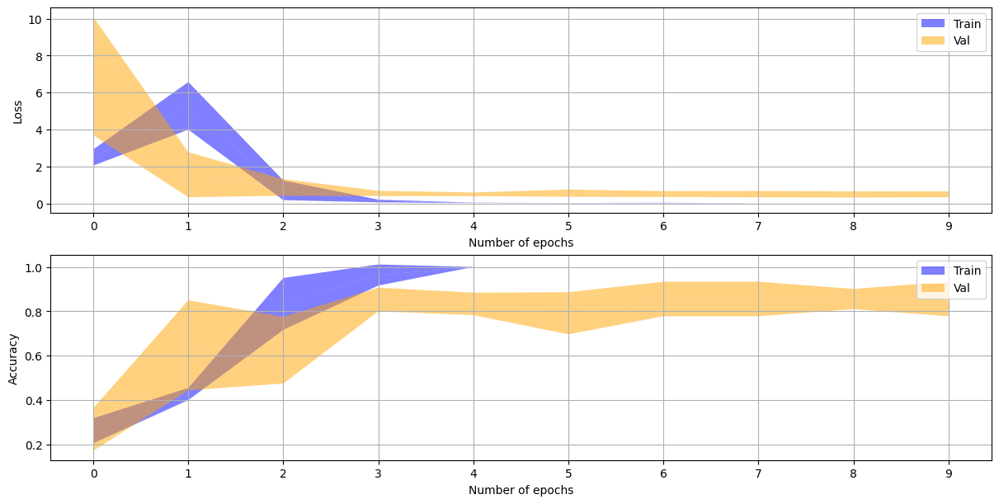

In [13]:
import matplotlib.pyplot as pl

fig, axs = plt.subplots(2, 1, constrained_layout=True, figsize=(12,6))

plot_kfold_mean_performance(axs[0], train_losses, val_losses, "Loss")
plot_kfold_mean_performance(axs[1], train_accuracies, val_accuracies, "Accuracy")

print(f'Train Loss function: {np.mean(np.array(train_losses)[:, -1])}')
print(f'Train Accuracy: {np.mean(np.array(train_accuracies)[:, -1])}')
print('-----------------------------------------')
print(f'Val Loss function: {np.mean(np.array(val_losses)[:, -1])}')
print(f'Val Accuracy: {np.mean(np.array(val_accuracies)[:, -1])}')

## Evaluate model on test set

**TODO**: when you've selected a final model, evaluate its performances (f-score, confusion matrix, ...) on your test set

In [14]:
# First retrain model on all the training data
train_images = open_images(total_train_paths)
train_labels = total_train_labels

model = get_model() # We reinitialize the model

history = model.fit(
    x=train_images,
    y=train_labels,
    batch_size=32,
    epochs=NB_EPOCHS,
)

Epoch 1/10
2/2 [==============================] - 3s 297ms/step - loss: 4.4435 - acc: 0.2083
Epoch 2/10
2/2 [==============================] - 1s 310ms/step - loss: 2.0739 - acc: 0.5417
Epoch 3/10
2/2 [==============================] - 1s 308ms/step - loss: 0.6374 - acc: 0.8125
Epoch 4/10
2/2 [==============================] - 1s 301ms/step - loss: 0.0597 - acc: 1.0000
Epoch 5/10
2/2 [==============================] - 1s 301ms/step - loss: 0.0344 - acc: 1.0000
Epoch 6/10
2/2 [==============================] - 1s 298ms/step - loss: 0.0280 - acc: 1.0000
Epoch 7/10
2/2 [==============================] - 1s 284ms/step - loss: 0.0245 - acc: 1.0000
Epoch 8/10
2/2 [==============================] - 1s 286ms/step - loss: 0.0160 - acc: 1.0000
Epoch 9/10
2/2 [==============================] - 1s 282ms/step - loss: 0.0133 - acc: 1.0000
Epoch 10/10
2/2 [==============================] - 1s 286ms/step - loss: 0.0115 - acc: 1.0000


In [15]:
import sklearn.metrics as me

test_images = open_images(test_df['path'])

predict_full = model.predict(test_images)
predict = np.argmax(predict_full, axis=-1)

label_encoder = LabelEncoder()
label_encoder.fit(test_df['label'])
y_test = label_encoder.transform(test_df['label'])

test_confusion_matrix = me.confusion_matrix(y_test, predict, labels=np.arange(len(LABEL_NAMES)))

1/1 [==============================] - 1s 970ms/step


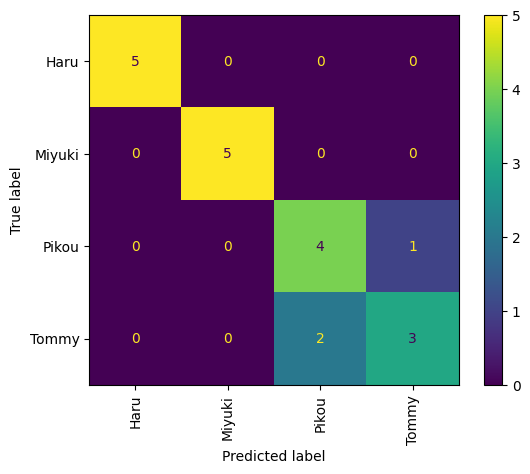

In [16]:
confusion_matrix_display = me.ConfusionMatrixDisplay(
    confusion_matrix=test_confusion_matrix,
    display_labels=LABEL_NAMES,
)

confusion_matrix_display.plot(xticks_rotation='vertical')
plt.show()

### Display some misclassified images

**TODO**: display some misclassified images to be able to see what images are difficult for the model

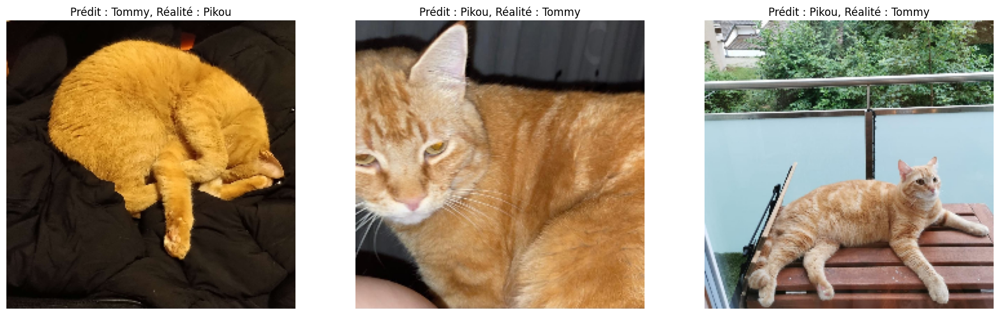

In [17]:
error_filter = predict != y_test
error_filter_idx = np.where(error_filter)[0]

plt.figure(figsize=(20, 20))

for i, index in enumerate(error_filter_idx):
    ax = plt.subplot(3, 3, i + 1)
    plt.title("Prédit : " + str(LABEL_NAMES[predict[index]]) + ", Réalité : " + str(test_df['label'][index]))
    plt.imshow(open_image(test_df['path'][index]))
    plt.axis("off")

## Use grad-cam to inspect how the model classify
Here we can see an heatmap of the regions that activates the model the most.

### For more information:
- tf-keras-vis documentation: https://keisen.github.io/tf-keras-vis-docs/
- Grad-cam paper: https://arxiv.org/pdf/1610.02391.pdf
- Grad-cam++ paper: https://arxiv.org/pdf/1710.11063.pdf

**NOTE**: maybe you will need to adapt some variable names based on your code above. For example, _model_ should be the model trained on all the training data. 

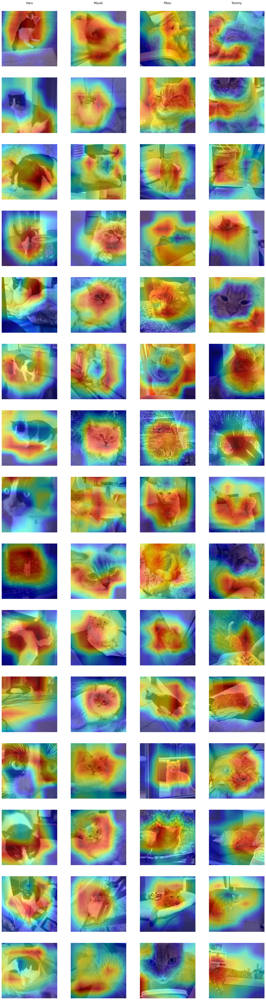

In [18]:
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import cm
from tensorflow.keras.applications import MobileNetV2
from tf_keras_vis.gradcam_plus_plus import GradcamPlusPlus
from tf_keras_vis.utils.model_modifiers import ReplaceToLinear
from tf_keras_vis.utils.scores import CategoricalScore

# Create GradCAM++ object
gradcam = GradcamPlusPlus(
    model,
    model_modifier=ReplaceToLinear(),
    clone=True,
)

nb_images_per_class = 15

fig, axs = plt.subplots(nb_images_per_class, len(LABEL_NAMES), figsize=(len(LABEL_NAMES) * 5, nb_images_per_class * 5))

for label_idx, label_name in enumerate(LABEL_NAMES):
    axs[0,label_idx].set_title(label_name, loc='center', y=1.1)
    
    i = 0
    for _, rowdata in train_df[train_df['label'] == label_name].sample(frac=1).head(nb_images_per_class).iterrows():
        img = open_image(rowdata.path)    
        pred = model(np.expand_dims(img, axis=0))

        # Generate cam with GradCAM++
        score = CategoricalScore(np.argmax(pred))
        cam = gradcam(score, img)
        heatmap = np.uint8(cm.jet(cam[0])[..., :3] * 255)

        axs[i,label_idx].imshow(img, vmin=0, vmax=1)
        axs[i,label_idx].imshow(heatmap, cmap='jet', alpha=0.5) # overlay
        axs[i,label_idx].axis("off")

        i += 1

### Grad-cam on misclassified images

**TODO**: now do the same than above, but with the misclassified images. You shouldn't change anything pertaining to grad-cam besides on which image and prediction you do it

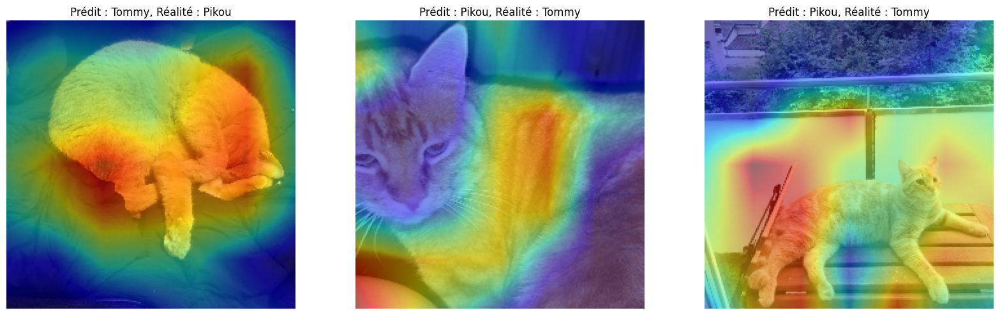

In [19]:
gradcam = GradcamPlusPlus(
    model,
    model_modifier=ReplaceToLinear(),
    clone=True,
)
plt.figure(figsize=(20, 20))


for i, index in enumerate(error_filter_idx):
    ax = plt.subplot(3, 3, i + 1)
    plt.title("Prédit : " + str(LABEL_NAMES[predict[index]]) + ", Réalité : " + str(test_df['label'][index]))
    img = open_image(test_df['path'][index])
    pred = model(np.expand_dims(img, axis=0))

    # Generate cam with GradCAM++
    score = CategoricalScore(np.argmax(pred))
    cam = gradcam(score, img)
    heatmap = np.uint8(cm.jet(cam[0])[..., :3] * 255)

    plt.imshow(img, vmin=0, vmax=1)
    plt.imshow(heatmap, cmap='jet', alpha=0.5) # overlay
    plt.axis("off")

**TODO**: try to determine what caused the misclassifcations and what you can do about it

see => report

In [20]:
# Source : https://www.tensorflow.org/tutorials/keras/classification?hl=fr

def plot_image(i, predictions_array, true_label, img):
    true_label, img = true_label[i], img[i]
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])

    plt.imshow(img, cmap=plt.cm.binary)

    predicted_label = np.argmax(predictions_array)
    if predicted_label == true_label:
        color = 'blue'
    else:
        color = 'red'

    plt.xlabel("{} {:2.0f}% ({})".format(LABEL_NAMES[predicted_label],
                                         100*np.max(predictions_array),
                                         LABEL_NAMES[true_label]),
               color=color)

def plot_value_array(i, predictions_array, true_label):
    true_label = true_label[i]
    plt.grid(False)
    plt.xticks(range(len(LABEL_NAMES)))
    plt.yticks([])
    thisplot = plt.bar(range(len(LABEL_NAMES)), predictions_array, color="#777777")
    plt.ylim([0, 1])
    predicted_label = np.argmax(predictions_array)

    thisplot[predicted_label].set_color('red')
    thisplot[true_label].set_color('blue')

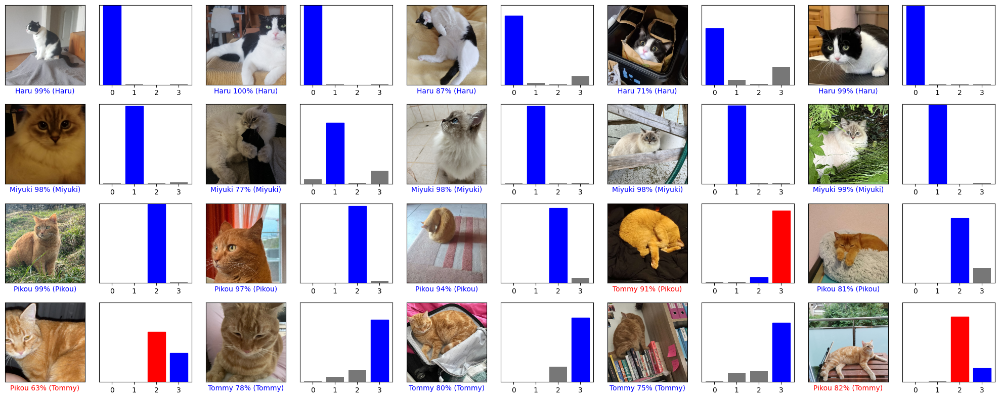

In [21]:
num_rows = 4
num_cols = 3
num_images = num_rows*num_cols
plt.figure(figsize=(2*2*num_cols, 2*num_rows))
for i in range(num_images):
    plt.subplot(num_rows, 2*num_cols, 2*i+1)
    plot_image(i, predict_full[i], y_test, test_images)
    plt.subplot(num_rows, 2*num_cols, 2*i+2)
    plot_value_array(i, predict_full[i], y_test)
plt.tight_layout()
plt.show()
